# Fitting ellipses to James Webb Space Telescope's cartwheel galaxy images

In [1]:
import Pkg

# activate parent environment
Pkg.activate(normpath(joinpath(@__DIR__, ".")))
Pkg.resolve()
Pkg.instantiate()
Pkg.status()

using Clustering
using Wavelets
using WaveletsExt

using Images
using ImageEdgeDetection
using ImageEdgeDetection: Percentile
using ImageFeatures

using DSP
using Plots

using LinearAlgebra
using SCS
using JuMP

  Activating project at `c:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Manifest.toml`


Status `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  [1e616198] COSMO v0.8.9
  [aaaa29a8] Clustering v0.15.7
⌅ [5ae59095] Colors v0.12.11
  [717857b8] DSP v0.7.10
  [5789e2e9] FileIO v1.16.6
  [87dc4568] HiGHS v1.12.1
  [2b14c160] ImageEdgeDetection v0.1.8
  [92ff4b2b] ImageFeatures v0.5.3
  [4e3cecfd] ImageShow v0.3.8
  [86fae568] ImageView v0.12.6
  [916415d5] Images v0.26.1
  [4076af6c] JuMP v1.23.5
  [429524aa] Optim v1.10.0
⌃ [91a5bcdd] Plots v1.40.7
  [c946c3f1] SCS v2.0.2
  [29a6e085] Wavelets v0.10.0
  [8f464e1e] WaveletsExt v0.2.2
Info Packages marked with ⌃ and ⌅ have new versions available. Those with ⌃ may be upgradable, but those with ⌅ are restricted by compatibility constraints from upgrading. To see why use `status --outdated`


## Read the image

Image size: (1024, 1024) - image dyadic size: (true, true)


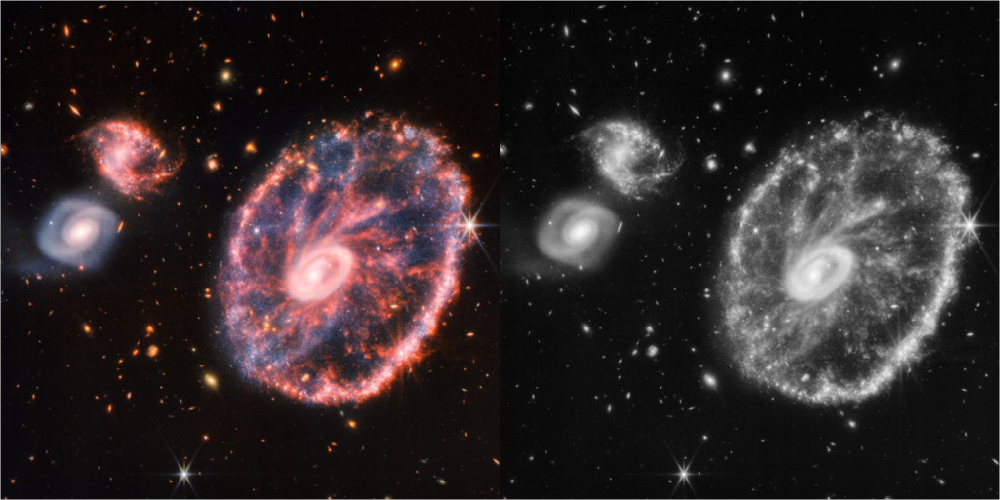

In [2]:
# read image (cartwheel galaxy)
directory_path = "."
image_path = joinpath(directory_path, "cartwheel_galaxies_JWST.png")
img = load(image_path)
println("Image size: ", size(img), " - image dyadic size: ", isdyadic.(size(img)))

# convert image to gray scale
img_gray = Gray.(img)
mosaicview(img, img_gray; nrow=1)

## Denoise image

In [6]:
function mexican_hat_filter(n)
    filter = zeros(n, n)
    for i in 1:n
        for j in 1:n
            x = i - n / 2
            y = j - n / 2
            filter[i, j] = (1 - (x^2 + y^2) / (n^2)) * exp(-(x^2 + y^2) / (2 * n^2))
        end
    end
    return filter
end

function plot_dwt(x)
    plt = heatmap(x, color=:grays, aspect_ratio=1, cbar=false,
        xlims=(0, size(x, 2)),
        ylims=(0, size(x, 1)),
        size=(900, 900),
        dpi=300
    )
end

function flip(x)
    return x[end:-1:1, :]
end

function normalize(x)
    x = (x .- minimum(x)) ./ (maximum(x) - minimum(x))
    return x
end

normalize (generic function with 1 method)

In [88]:
x = convert(Array{Float64}, img_gray)

# apply the mexican hat filter
K = 5
S = Int(floor((K / 2)))
mh_filter = mexican_hat_filter(K)

x̂_filt = DSP.conv(Matrix{Float64}(x), mh_filter)
N, M = size(x̂_filt)
x̂_filt = x̂_filt[S+1:N-S, S+1:M-S]

1024×1024 Matrix{Float64}:
 0.157043  0.200551  0.240769  0.24672   …  0.412568  0.328401  0.236123
 0.187599  0.24407   0.282783  0.28056      0.520862  0.421799  0.308543
 0.23005   0.307365  0.354057  0.335783     0.604488  0.488134  0.352386
 0.218068  0.307341  0.360437  0.338173     0.618746  0.503379  0.362293
 0.206448  0.300784  0.34778   0.333535     0.616405  0.504109  0.363662
 0.205608  0.297785  0.341079  0.325896  …  0.616426  0.499683  0.357448
 0.218633  0.304888  0.346308  0.340643     0.648864  0.520522  0.366446
 0.218568  0.286348  0.328251  0.334757     0.657101  0.53102   0.375635
 0.205184  0.255591  0.302331  0.306045     0.638512  0.51593   0.368953
 0.207431  0.251904  0.301292  0.300745     0.620289  0.496304  0.358659
 ⋮                                       ⋱                      
 0.477717  0.66946   0.827043  0.8804    …  1.08046   0.858827  0.609636
 0.482289  0.682795  0.844916  0.906488     1.02841   0.823395  0.584092
 0.525576  0.736265  0.897247  0

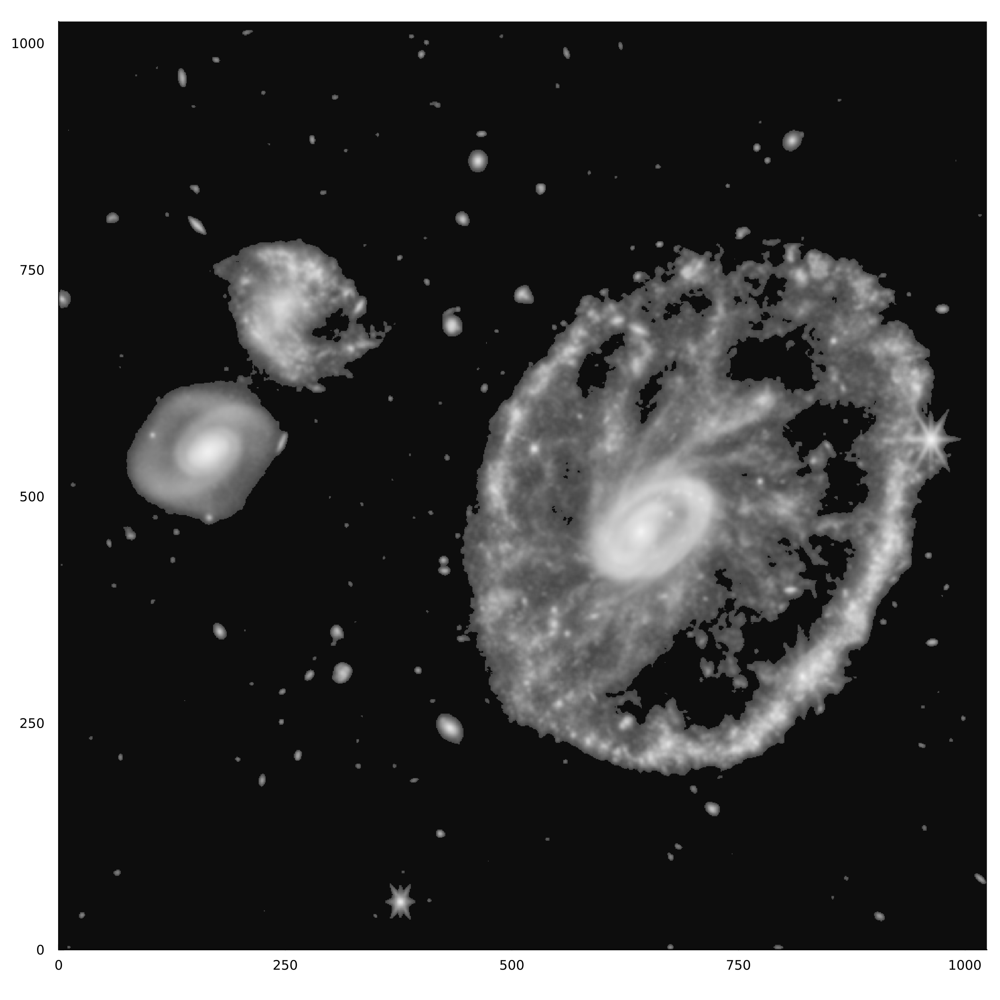

In [98]:
wt = wavelet(WT.coif4)
x̂_wt = wpd(x̂_filt, wt)
# x̂_wt = normalize(x̂_wt)

threshold!(x̂_wt, HardTH(), 4.75)
x̂_final = flip(x̂_wt[:, :, 1])
plot_dwt(x̂_final)

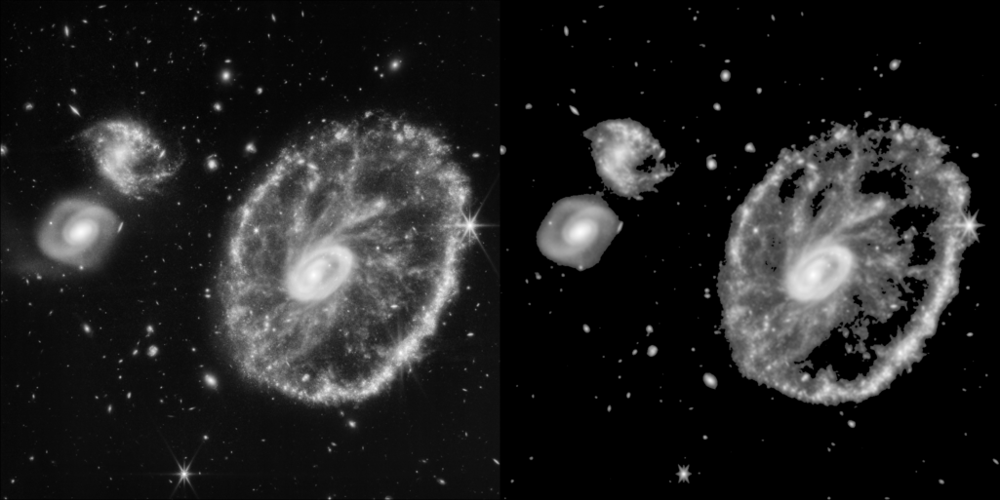

In [99]:
# plot the denoised image
x = normalize(x)
x̂_final = flip(normalize(x̂_final))
mosaicview(Gray.(x), Gray.(x̂_final); nrow=1)

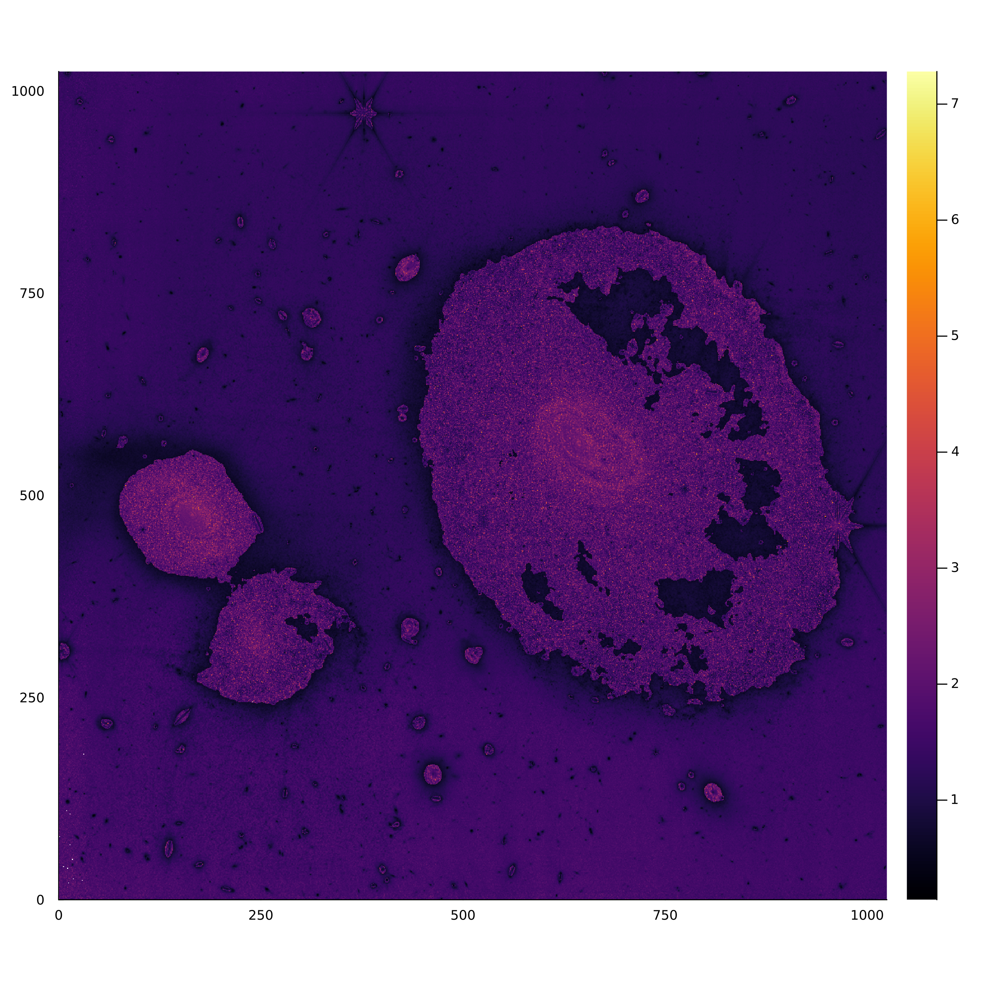

In [100]:
x_diff = -log10.(abs.(x .- x̂_final))
heatmap(x_diff, aspect_ratio=1,
    cbar=true,
    xlims=(0, size(x, 2)),
    ylims=(0, size(x, 1)),
    size=(900, 900),
    dpi=300
)

## Binarization

In [101]:
function canny_edge_detector(f_smooth::Matrix{Float64}, d1::Float64=0.1, d2::Float64=0.1)
    # Dimensions of the image
    rows, cols = size(f_smooth)

    # Preallocate arrays for gradient and Laplacian
    gradient_magnitude = zeros(Float64, rows, cols)
    laplacian_magnitude = zeros(Float64, rows, cols)
    edge_matrix = zeros(Bool, rows, cols)  # Binary matrix for edges

    # Sobel filters
    sobel_x = [-1 0 1; -2 0 2; -1 0 1]
    sobel_y = [-1 -2 -1; 0 0 0; 1 2 1]
    sobel_xx = [-1 2 -1; 2 -4 2; -1 2 -1]
    sobel_yy = [-1 2 -1; 2 -4 2; -1 2 -1]

    # Convolve the image with the Sobel filters
    gradient_x = conv(f_smooth, sobel_x)
    gradient_y = conv(f_smooth, sobel_y)

    # Compute the gradient magnitude
    gradient_magnitude = sqrt.(gradient_x .^ 2 + gradient_y .^ 2)

    # second derivative
    gradient_xx = conv(f_smooth, sobel_xx)
    gradient_yy = conv(f_smooth, sobel_yy)
    laplacian_magnitude = sqrt.(gradient_xx .^ 2 + gradient_yy .^ 2)

    # thresholding with d1, d2
    for i in 1:rows
        for j in 1:cols
            if gradient_magnitude[i, j] > d1 && laplacian_magnitude[i, j] < d2
                edge_matrix[i, j] = true
            end
        end
    end

    return edge_matrix, gradient_magnitude, laplacian_magnitude
end

canny_edge_detector (generic function with 3 methods)

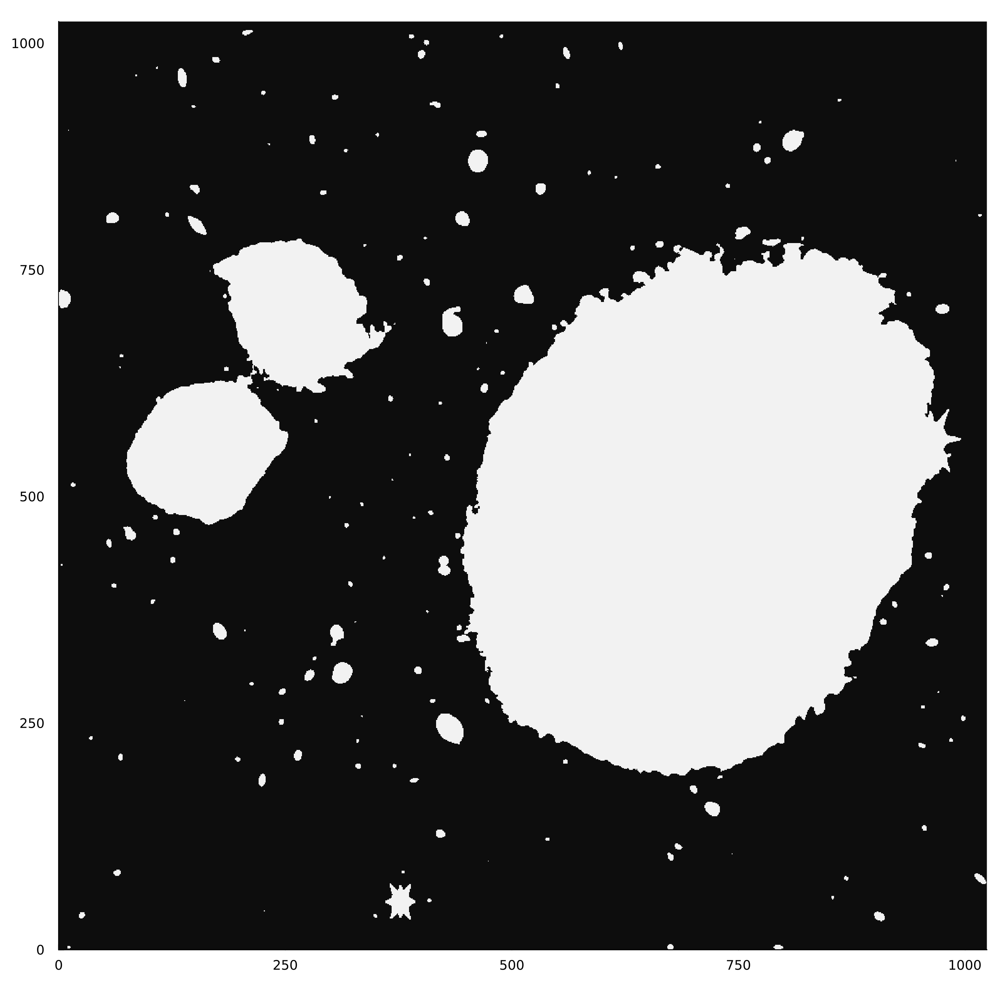

In [116]:
# binarization
x̂_bin = binarize(x̂_final, Otsu(); nbins=24)
x̂_bin = Matrix{Bool}(1 .- x̂_bin)
x̂_bin = imfill(x̂_bin, (0.0, 30000))
x̂_bin = Matrix{Bool}(1 .- x̂_bin)
plot_dwt(flip(x̂_bin))

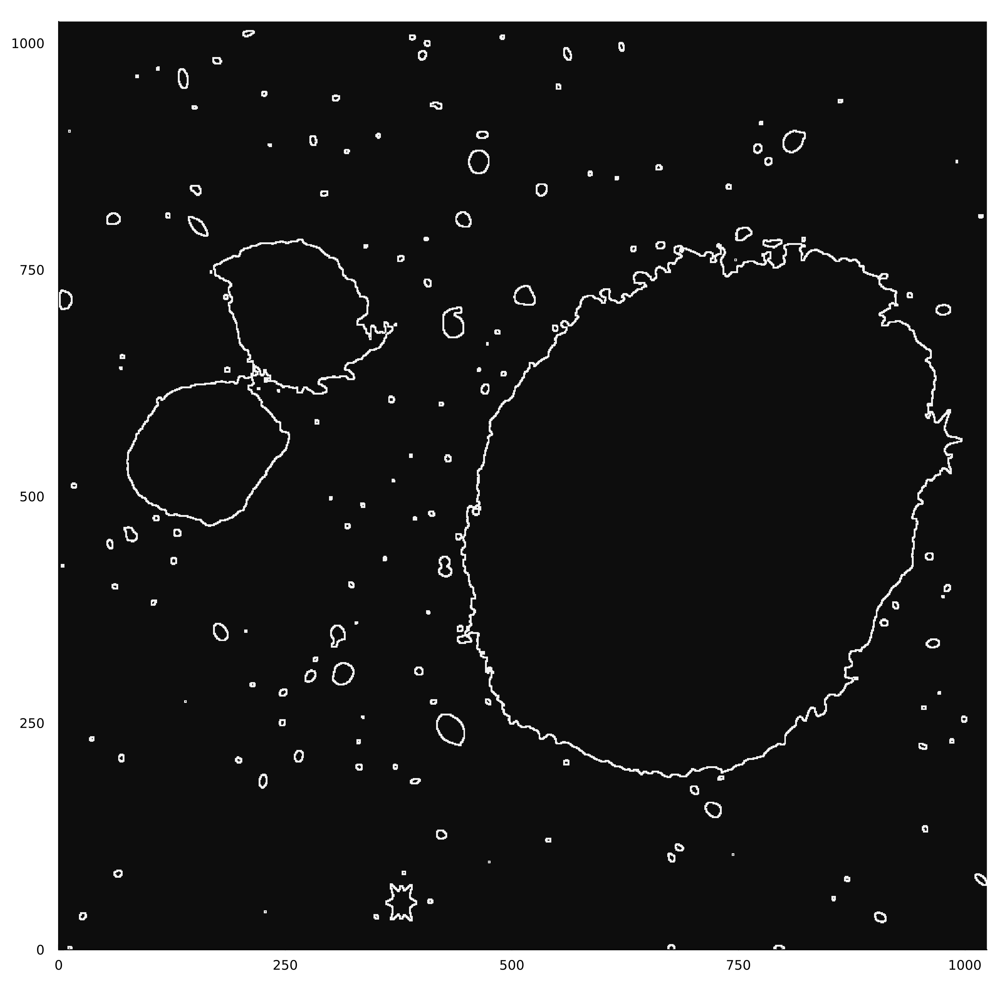

In [117]:
# canny
canny(d1, d2) = canny_edge_detector(Matrix{Float64}(x̂_bin), d1, d2)[1]
edges = canny(1e-3, 1e1)
plot_dwt(flip(edges))

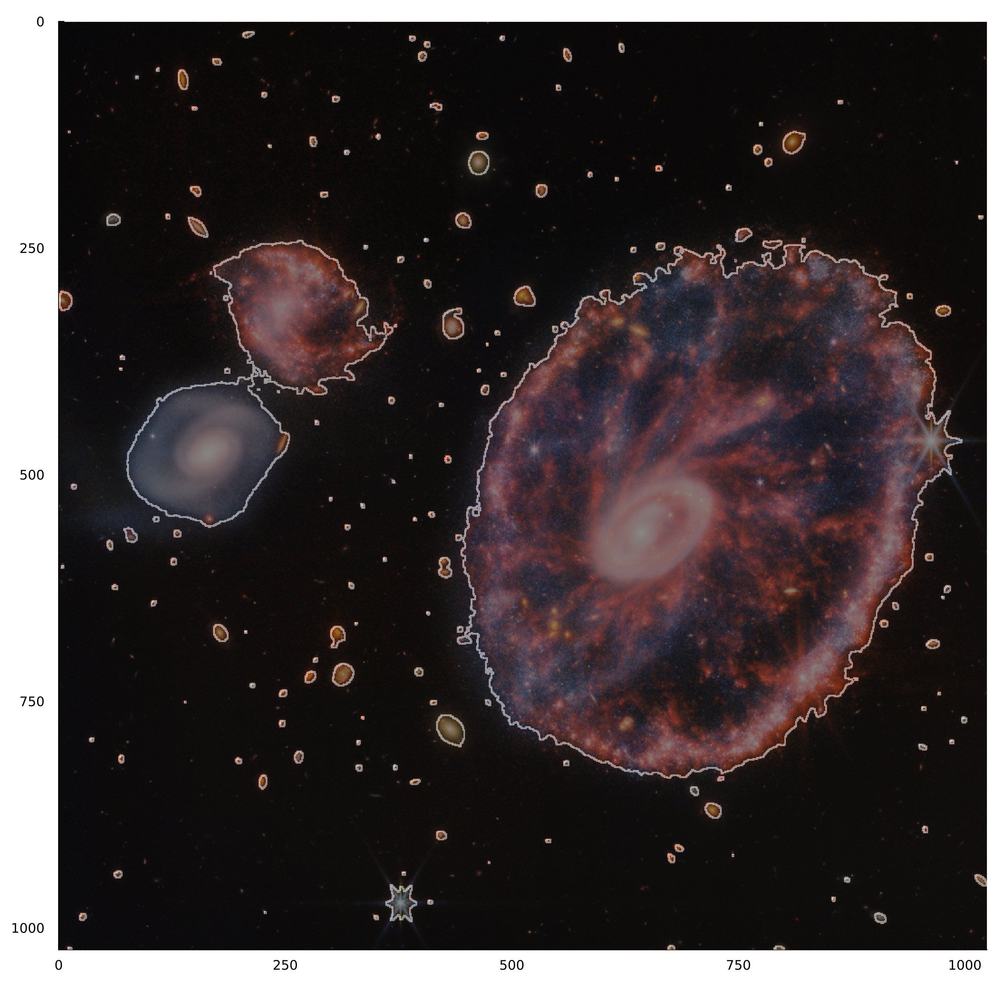

In [ ]:
# overlay the edges on top of the original image
# edges = edges[end:-1:1, :]
plt_res = heatmap(
    img,
    aspect_ratio=1,
    cbar=false,
    xlims=(0, size(img, 2)),
    ylims=(0, size(img, 1)),
    size=(900, 900),
    dpi=300
)
heatmap!(plt_res, edges, color=:grays, alpha=0.5)
savefig(plt_res, "cartwheel_edges.png")
display(plt_res)

In [ ]:
points = Vector{Vector{Int}}()
for i in 1:size(edges, 1)
    for j in 1:size(edges, 2)
        if edges[i, j]
            push!(points, [i, j])
        end
    end
end

points = hcat(points...)
points = convert(Matrix{Float64}, points)
result = dbscan(points, 2.0, min_neighbors=2, min_cluster_size=3)

# Plot the points with the colors of the clusters
N_int = 4
x = Int.(points[2, :])
y = Int.(points[1, :])
groups = result.assignments
N_clusters = maximum(groups)

# create array of tuples(x, y, group)
points = [(x[i], y[i], groups[i]) for i in 1:length(x)];

19106-element Vector{Tuple{Int64, Int64, Int64}}:
 (207, 11, 1)
 (208, 11, 1)
 (209, 11, 1)
 (210, 11, 1)
 (211, 11, 1)
 (212, 11, 1)
 (213, 11, 1)
 (214, 11, 1)
 (215, 11, 1)
 (204, 12, 1)
 ⋮
 (680, 1024, 153)
 (789, 1024, 154)
 (790, 1024, 154)
 (791, 1024, 154)
 (792, 1024, 154)
 (798, 1024, 154)
 (799, 1024, 154)
 (800, 1024, 154)
 (801, 1024, 154)

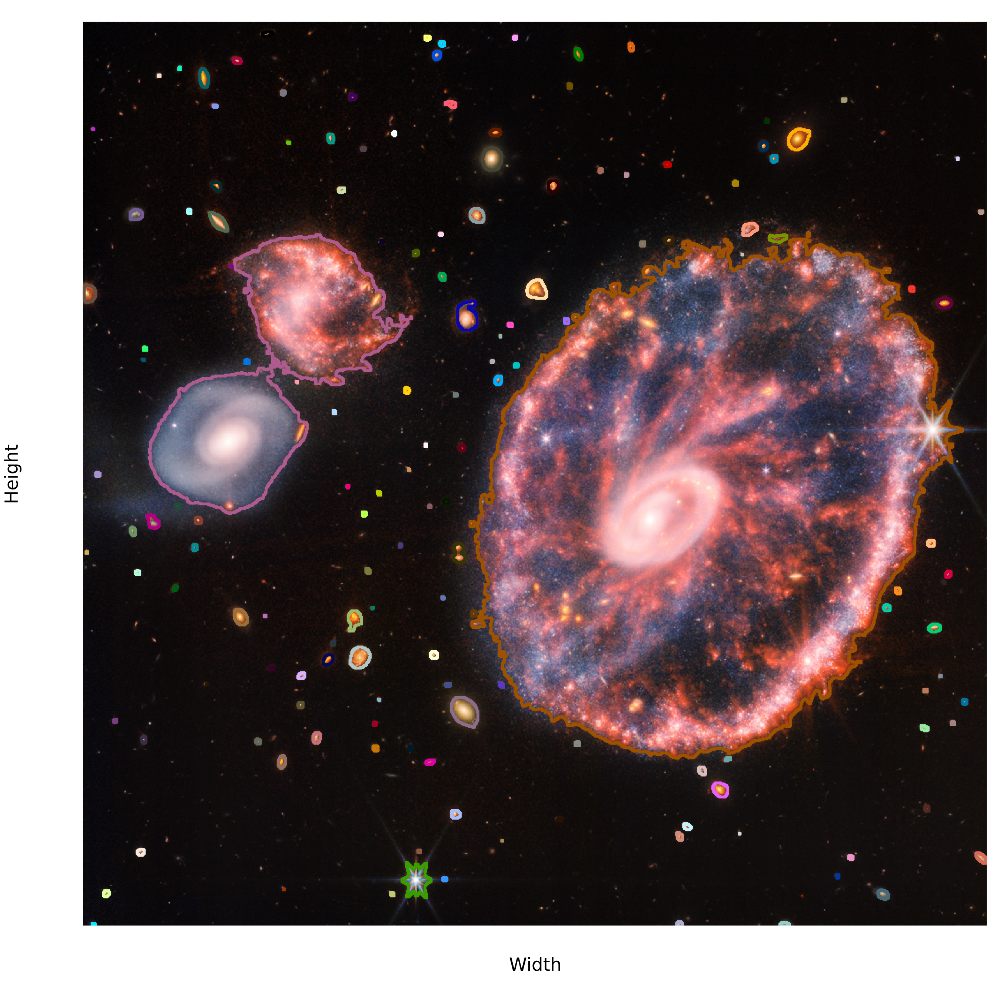

In [125]:
# Define a palette of colors
colors = distinguishable_colors(N_clusters);

# Plot the points with the colors of the clusters
plt_res = heatmap(img, aspect_ratio=1, cbar=false, legend=false,
    ylims=(0, size(img, 1)),
    xlims=(0, size(img, 2)),
    size=(900, 900),
    dpi=300
)
for (x, y, group) in points
    scatter!(plt_res, [x], [y], color=colors[group], label="Cluster $group", markerstrokewidth=0, markersize=1)
end

# Display the plot
plot!(plt_res,
    xlabel="Width",
    ylabel="Height",
    axis=false,
    legend=false,
)